# Simulation Examples

In [1]:
import numpy as np
from Project import Person, virus, Simulation

In [2]:
# Properties of Virus

# Probability of healthy person infected by a carrier
h = lambda dist: 1/10/dist**2

# The next step of a sick person
# Under current setting, the case fatality rate is 10%
i = lambda: np.random.choice(["infected", "dead", "recovered"], size=1, p=[0.95, 0.005, 0.045])
mutation_rate = 0.0
mask_penetration = .00
vaccine_effectiveness = 0.000

this_virus = virus(h, i, mutation_rate)

## Simulation 1: Simple case
10 * 10 board with 20 people, (30% initial infected)

In [3]:
sim = Simulation(board_shape=(14,14), ts=100, num_people=60, percentage_infected=.3, virus=this_virus, seed=0, percentage_masked=0, percentage_vacc=0)

In [4]:
# Initial board
sim.board

[[0, 0, 0, h, 0, h, 0, 0, 0, 0, i, h, 0, 0],
 [h, h, 0, h, i, 0, h, 0, 0, 0, 0, h, 0, 0],
 [0, 0, h, 0, 0, 0, h, 0, 0, 0, 0, h, i, h],
 [0, h, h, 0, h, 0, 0, 0, 0, h, i, 0, 0, 0],
 [i, 0, 0, 0, 0, i, 0, 0, i, 0, i, 0, 0, 0],
 [0, h, 0, 0, 0, 0, 0, i, 0, i, 0, 0, 0, 0],
 [0, h, 0, h, 0, i, 0, h, 0, 0, 0, 0, 0, 0],
 [0, h, h, 0, 0, 0, h, 0, 0, 0, h, 0, 0, i],
 [0, h, 0, 0, 0, h, 0, h, h, 0, 0, h, 0, 0],
 [0, 0, h, 0, h, 0, 0, 0, 0, h, 0, 0, 0, i],
 [0, 0, 0, h, 0, h, 0, 0, 0, 0, 0, 0, h, 0],
 [0, 0, i, 0, h, 0, 0, h, 0, 0, 0, i, 0, 0],
 [0, i, i, h, 0, h, 0, 0, h, 0, 0, 0, 0, 0],
 [0, 0, 0, 0, 0, 0, 0, i, h, 0, 0, h, 0, 0]]

In [5]:
sim.simulate(verbose=False)

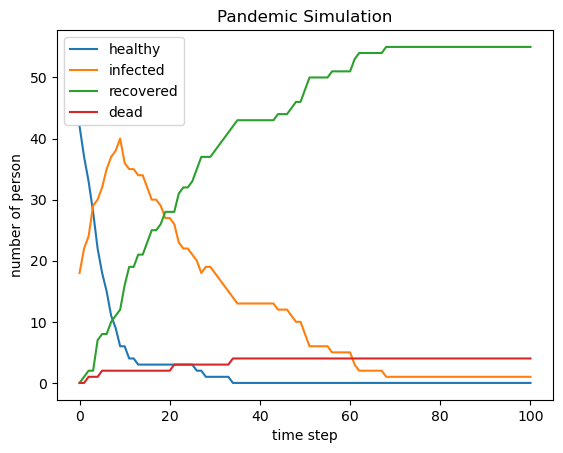

In [6]:
sim.plot()

In [7]:
# Board of every step
sim.record['board']

[[[0, 0, 0, h, 0, h, 0, 0, 0, 0, i, h, 0, 0],
  [h, h, 0, h, i, 0, h, 0, 0, 0, 0, h, 0, 0],
  [0, 0, h, 0, 0, 0, h, 0, 0, 0, 0, h, i, h],
  [0, h, h, 0, h, 0, 0, 0, 0, h, i, 0, 0, 0],
  [i, 0, 0, 0, 0, i, 0, 0, i, 0, i, 0, 0, 0],
  [0, h, 0, 0, 0, 0, 0, i, 0, i, 0, 0, 0, 0],
  [0, h, 0, h, 0, i, 0, h, 0, 0, 0, 0, 0, 0],
  [0, h, h, 0, 0, 0, h, 0, 0, 0, h, 0, 0, i],
  [0, h, 0, 0, 0, h, 0, h, h, 0, 0, h, 0, 0],
  [0, 0, h, 0, h, 0, 0, 0, 0, h, 0, 0, 0, i],
  [0, 0, 0, h, 0, h, 0, 0, 0, 0, 0, 0, h, 0],
  [0, 0, i, 0, h, 0, 0, h, 0, 0, 0, i, 0, 0],
  [0, i, i, h, 0, h, 0, 0, h, 0, 0, 0, 0, 0],
  [0, 0, 0, 0, 0, 0, 0, i, h, 0, 0, h, 0, 0]],
 [[0, h, 0, 0, h, 0, h, 0, 0, i, 0, 0, h, 0],
  [0, 0, 0, i, i, 0, 0, 0, 0, 0, 0, i, 0, h],
  [h, h, h, h, h, 0, 0, h, 0, 0, 0, 0, h, 0],
  [0, h, 0, 0, 0, 0, 0, 0, h, 0, i, 0, i, 0],
  [0, i, 0, 0, 0, 0, i, i, 0, r, 0, 0, 0, 0],
  [0, 0, h, 0, 0, 0, 0, 0, i, 0, i, 0, 0, 0],
  [0, h, 0, 0, h, 0, i, 0, 0, 0, 0, 0, 0, i],
  [0, 0, 0, h, 0, i, h, 0, 0, 0, 

## Simulation 2: KD-tree accelerate simulation
400*400 board with 10,000 people (10% infected)

In [8]:
sim = Simulation(board_shape=(400,400), ts=200, num_people=10000, percentage_infected=.1, virus=this_virus, seed=10)

In [9]:
# Remark: If we don't use KD-tree, it takes too much time for the simulation
sim.simulate(KD=True)

100%|█████████████████████████████████████████| 200/200 [03:31<00:00,  1.06s/it]


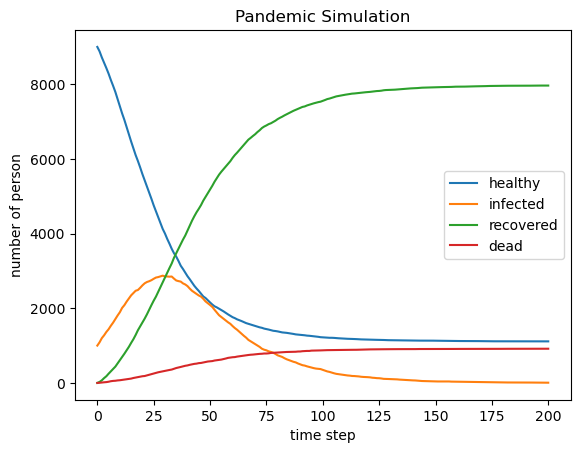

In [10]:
sim.plot()

## Simulation 3 Moving Strategies and Animation
100 * 100 board with 500 people, (10% infected)

#### Random Walk

In [11]:
sim = Simulation(board_shape=(100,100), ts=200, num_people=500, strategy='random', percentage_infected=.1, virus=this_virus, seed=10)

In [12]:
sim.simulate(KD=True)

100%|█████████████████████████████████████████| 200/200 [00:07<00:00, 27.60it/s]


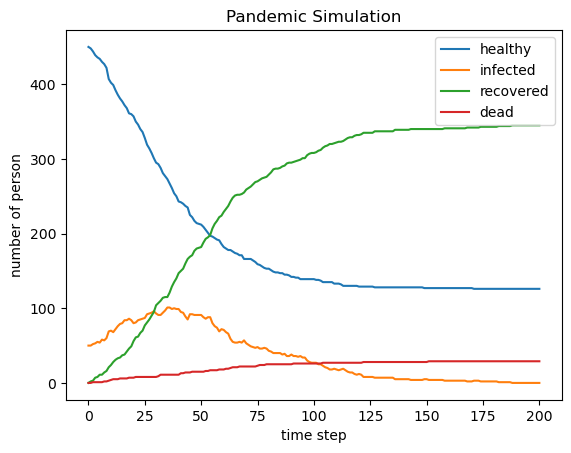

In [13]:
sim.plot()

In [14]:
sim.animate(save_path="gifs/random.gif")

MovieWriter ffmpeg unavailable; using Pillow instead.


In [15]:
# There are 450 healthy people in the beginning.
# The number of healthy people after 200 time steps:
sim.record['healthy'][-1]

126

#### Tends to stay away

In [16]:
sim = Simulation(board_shape=(100,100), ts=200, num_people=500, strategy='stayaway', percentage_infected=.1, virus=this_virus, seed=10)

In [17]:
sim.simulate(KD=True)

100%|█████████████████████████████████████████| 200/200 [00:27<00:00,  7.16it/s]


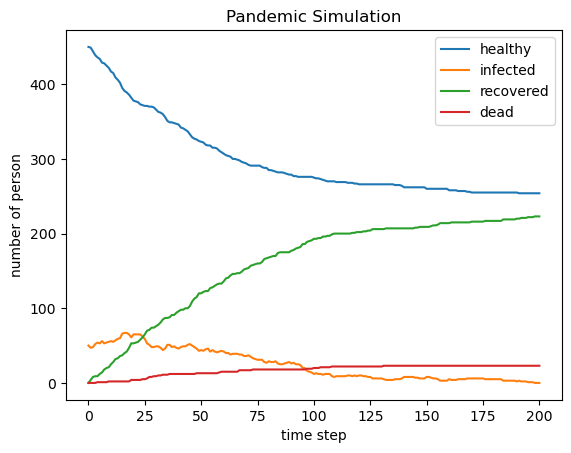

In [18]:
sim.plot()

In [19]:
sim.animate(save_path='gifs/stayaway.gif')

MovieWriter ffmpeg unavailable; using Pillow instead.


In [20]:
# There are 450 healthy people in the beginning.
# The number of healthy people after 200 time steps:
sim.record['healthy'][-1]

254

#### Tend to gather

In [21]:
sim = Simulation(board_shape=(100,100), ts=200, num_people=500, strategy='gather', percentage_infected=.1, virus=this_virus, seed=10)

In [22]:
sim.simulate(KD=True)

100%|█████████████████████████████████████████| 200/200 [00:26<00:00,  7.58it/s]


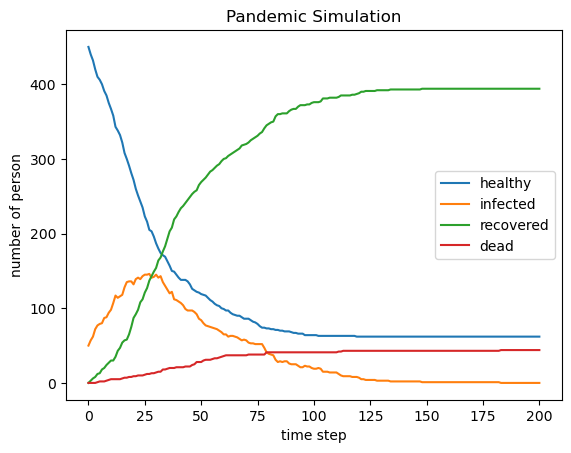

In [23]:
sim.plot()

In [24]:
sim.animate(save_path='gifs/gather.gif')

MovieWriter ffmpeg unavailable; using Pillow instead.


In [25]:
# There are 450 healthy people in the beginning.
# The number of healthy people after 200 time steps:
sim.record['healthy'][-1]

62

#### Tend to gather to the center of board

In [26]:
sim = Simulation(board_shape=(100,100), ts=200, num_people=500, strategy='party', percentage_infected=.1, virus=this_virus, seed=10)

In [27]:
sim.simulate(KD=True)

100%|█████████████████████████████████████████| 200/200 [00:08<00:00, 22.40it/s]


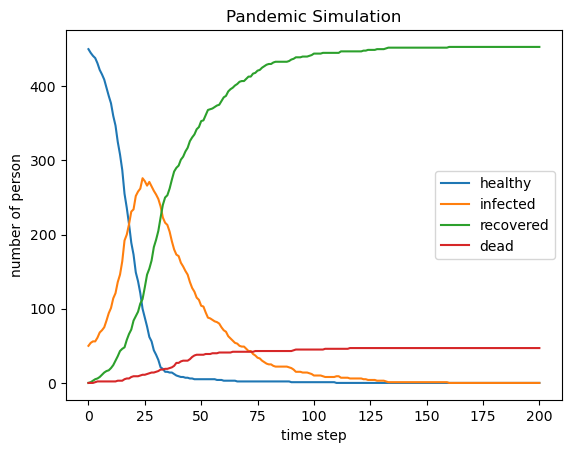

In [28]:
sim.plot()

In [29]:
sim.animate(save_path='gifs/party.gif')

MovieWriter ffmpeg unavailable; using Pillow instead.


In [30]:
# There are 450 healthy people in the beginning.
# The number of healthy people after 200 time steps:
sim.record['healthy'][-1]

0

## Simulation 4: Mutation
That is, a recovered person could be infected again. This shows various waves of the pandemic.

In [31]:
# Properties of Virus

# Probability of healthy person infected by a carrier
h = lambda dist: 1/10/dist**2

# The next step of a sick person
# Under current setting, the case fatality rate is 2%
i = lambda: np.random.choice(["infected", "dead", "recovered"], size=1, p=[0.95, 0.001, 0.049])

# Mutation rate: 10%: recovered have 1% possibility to switch to healthy every time step
mutation_rate = 0.01
mask_penetration = .00
vaccine_effectiveness = 0.000

this_virus = virus(h, i, mutation_rate)

In [32]:
sim = Simulation(board_shape=(100,100), ts=1000, num_people=500, percentage_infected=.1, virus=this_virus, seed=10)

In [33]:
sim.simulate(KD=True)

100%|███████████████████████████████████████| 1000/1000 [00:49<00:00, 20.24it/s]


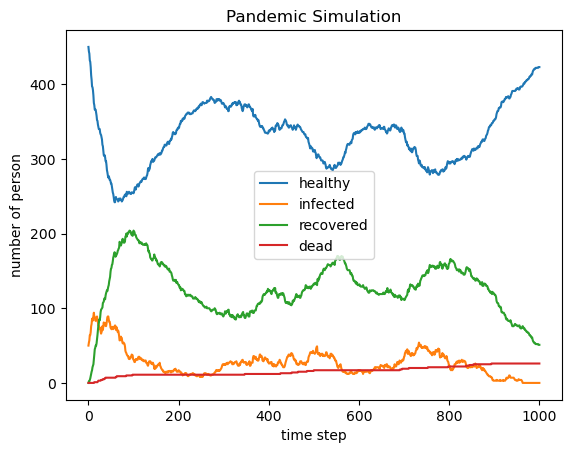

In [34]:
sim.plot()